In [2]:
import pandas as pd   # module to work with data in DataFrames.
import numpy as np
import matplotlib.pyplot as plt
import logging
import os
from PIL import Image
import json
from mpl_toolkits.axes_grid1 import ImageGrid

In [3]:
path = r"."
logging.basicConfig(filename='test.log', encoding='utf-8', level=logging.DEBUG, 
                    format = '%(asctime)s - %(levelname)s - %(name)s - %(message)s')

In [4]:
with open('img.json', 'r') as f:
    data = json.load(f)
    f.close()
print(json.dumps(data, indent=4))

{
    "183": {
        "test_image": "art_1_4.jpeg",
        "rotation": false,
        "image": "art_1",
        "category": "art",
        "sigma": "4"
    },
    "196": {
        "test_image": "nature_1_4.jpeg",
        "rotation": false,
        "image": "nature_1",
        "category": "nature",
        "sigma": "4"
    },
    "217": {
        "test_image": "portrait_1_4.jpeg",
        "rotation": false,
        "image": "portrait_1",
        "category": "portrait",
        "sigma": "4"
    },
    "230": {
        "test_image": "art_2_4.jpeg",
        "rotation": false,
        "image": "art_2",
        "category": "art",
        "sigma": "4"
    },
    "26": {
        "test_image": "nature_2_4.jpeg",
        "rotation": false,
        "image": "nature_2",
        "category": "nature",
        "sigma": "4"
    },
    "17": {
        "test_image": "portrait_2_4.jpeg",
        "rotation": false,
        "image": "portrait_2",
        "category": "portrait",
        "sigma": "4"
    }

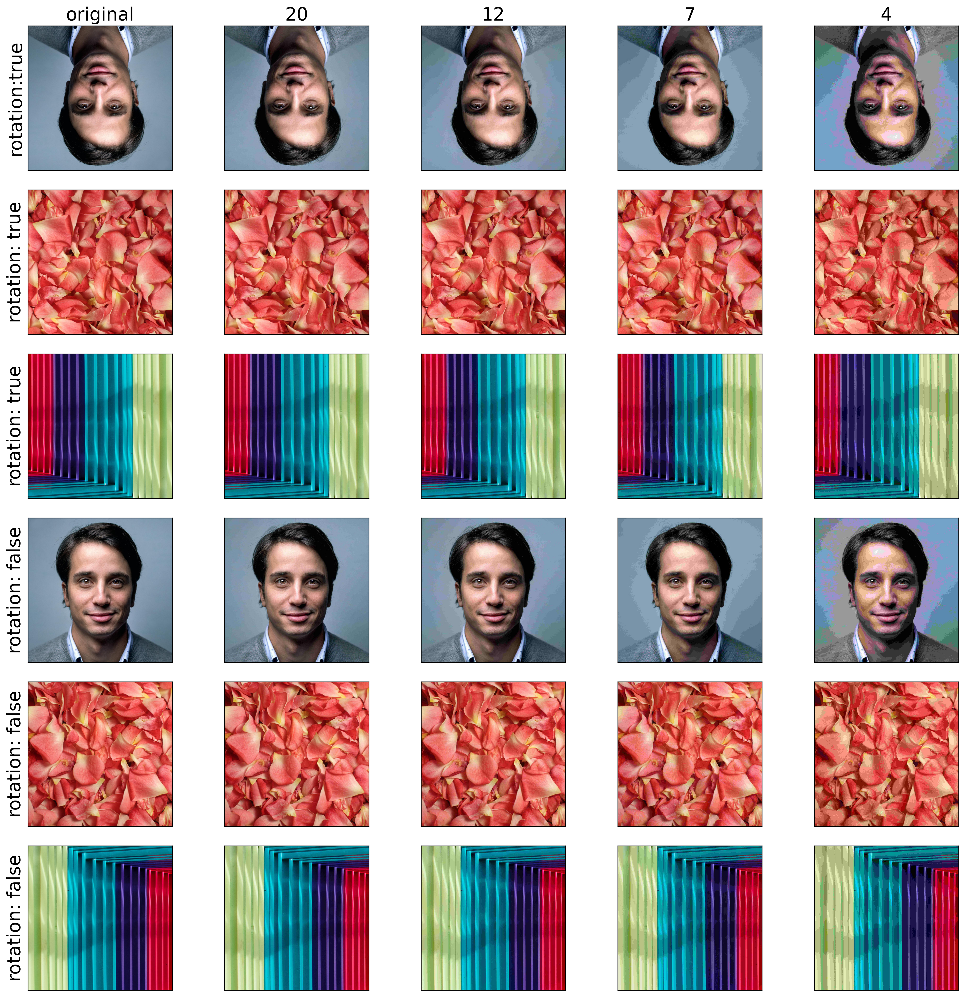

In [20]:
nature = np.array([data[x] for x in data if 'nature_3' in data[x]['image'] or 
                                 'portrait_3' in data[x]['image'] or 
                                    'art_3' in data[x]['image']])

nature = np.flip(nature, axis=0)
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(15, 15))
fig.set_dpi(300)            
fig.tight_layout(pad=.04)
cols = ["4", "7", "12", "20", "original"]
cols.reverse()
rows = ["rotation:true","rotation: true","rotation: true", 
        "rotation: false","rotation: false","rotation: false"]

    
for ax, col in zip(axes[0], cols):
    ax.set_title(col, size='xx-large', fontsize=20)

for ax, row in zip(axes[:,0], rows):
    ax.set_ylabel(row, rotation=90, size='xx-large', fontsize=20)


for ax, im in zip(axes.flatten('F'), nature):
    ax.imshow(Image.open(im['test_image']))
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    #ax.axis('off')
    ax.set_aspect('equal')

plt.show()
    